In [35]:
from tqdm import tqdm
import requests
import pandas as pd
from PIL import Image
import numpy as np
from matplotlib import pyplot as plt

In [36]:
# from google.colab import drive
# drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [37]:
# from google.colab import files
# files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"ayushsubedi","key":"3e35ef7e4ca7d5ebb110014575a431f4"}'}

In [38]:
# !ls -lha kaggle.json
# !pip install -q kaggle
# !mkdir -p ~/.kaggle
# !cp kaggle.json ~/.kaggle/
# !chmod 600 /root/.kaggle/kaggle.json

-rw-r--r-- 1 root root 67 May  3 03:31 kaggle.json


In [39]:
# !kaggle datasets download andrewmvd/ocular-disease-recognition-odir5k

100% 1.62G/1.62G [00:19<00:00, 99.8MB/s]
100% 1.62G/1.62G [00:19<00:00, 89.1MB/s]


In [40]:
# !unzip -qq /content/ocular-disease-recognition-odir5k.zip

In [43]:
df = pd.read_excel('/content/gdrive/MyDrive/ODIR-5K/ODIR-5K/data.xlsx')

In [44]:
df

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O
0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,1,0,0,0,0
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0
2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,1
3,3,66,Male,3_left.jpg,3_right.jpg,normal fundus,branch retinal artery occlusion,0,0,0,0,0,0,0,1
4,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3495,4686,63,Male,4686_left.jpg,4686_right.jpg,severe nonproliferative retinopathy,proliferative diabetic retinopathy,0,1,0,0,0,0,0,0
3496,4688,42,Male,4688_left.jpg,4688_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0
3497,4689,54,Male,4689_left.jpg,4689_right.jpg,mild nonproliferative retinopathy,normal fundus,0,1,0,0,0,0,0,0
3498,4690,57,Male,4690_left.jpg,4690_right.jpg,mild nonproliferative retinopathy,mild nonproliferative retinopathy,0,1,0,0,0,0,0,0


In [47]:
df = df[(df.N==1) | (df.G==1)]

In [49]:
df.N.value_counts()

1    1140
0     215
Name: N, dtype: int64

In [50]:
df.G.value_counts()

0    1140
1     215
Name: G, dtype: int64

In [51]:
df

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0
8,8,59,Male,8_left.jpg,8_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0
30,30,66,Female,30_left.jpg,30_right.jpg,post laser photocoagulation，glaucoma,post laser photocoagulation,0,0,1,0,0,0,0,1
43,43,35,Male,43_left.jpg,43_right.jpg,wet age-related macular degeneration,dry age-related macular degeneration，glaucoma,0,0,1,0,1,0,0,0
84,84,51,Female,84_left.jpg,84_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2826,3485,70,Male,3485_left.jpg,3485_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0
3015,4149,55,Male,4149_left.jpg,4149_right.jpg,low image quality,low image quality,1,0,0,0,0,0,0,0
3147,4290,51,Male,4290_left.jpg,4290_right.jpg,low image quality,normal fundus,1,0,0,0,0,0,0,0
3399,4571,51,Male,4571_left.jpg,4571_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0


In [55]:
df[df.G==1]

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O
30,30,66,Female,30_left.jpg,30_right.jpg,post laser photocoagulation，glaucoma,post laser photocoagulation,0,0,1,0,0,0,0,1
43,43,35,Male,43_left.jpg,43_right.jpg,wet age-related macular degeneration,dry age-related macular degeneration，glaucoma,0,0,1,0,1,0,0,0
95,95,46,Male,95_left.jpg,95_right.jpg,suspected glaucoma,hypertensive retinopathy,0,0,1,0,0,1,0,0
153,153,79,Male,153_left.jpg,153_right.jpg,glaucoma,dry age-related macular degeneration,0,0,1,0,1,0,0,0
167,167,71,Male,167_left.jpg,167_right.jpg,glaucoma,glaucoma,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1544,2032,48,Male,2032_left.jpg,2032_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy，suspect...,0,1,1,0,0,0,0,0
1546,2041,55,Female,2041_left.jpg,2041_right.jpg,glaucoma，wet age-related macular degeneration,tessellated fundus,0,0,1,0,1,0,0,1
1547,2048,63,Male,2048_left.jpg,2048_right.jpg,hypertensive retinopathy,glaucoma，old central retinal vein occlusion,0,0,1,0,0,1,0,1
1550,2063,77,Male,2063_left.jpg,2063_right.jpg,glaucoma，lens dust,glaucoma，moderate non proliferative retinopath...,0,1,1,0,0,0,0,1


In [ ]:
### Glaucoma

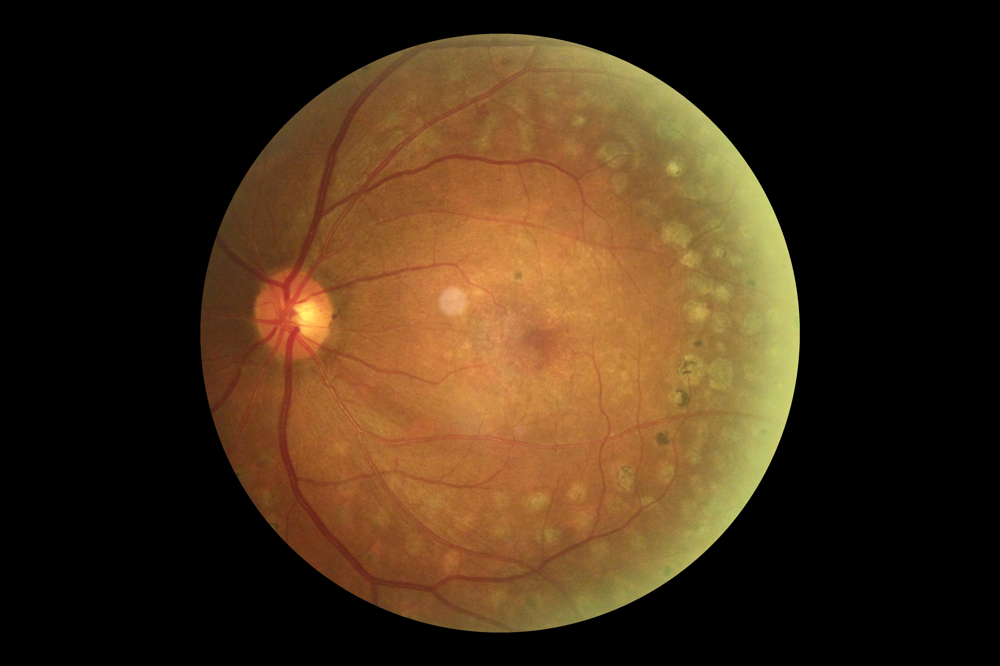

In [53]:
Image.open("/content/gdrive/MyDrive/ODIR-5K/ODIR-5K/Training Images/30_left.jpg")

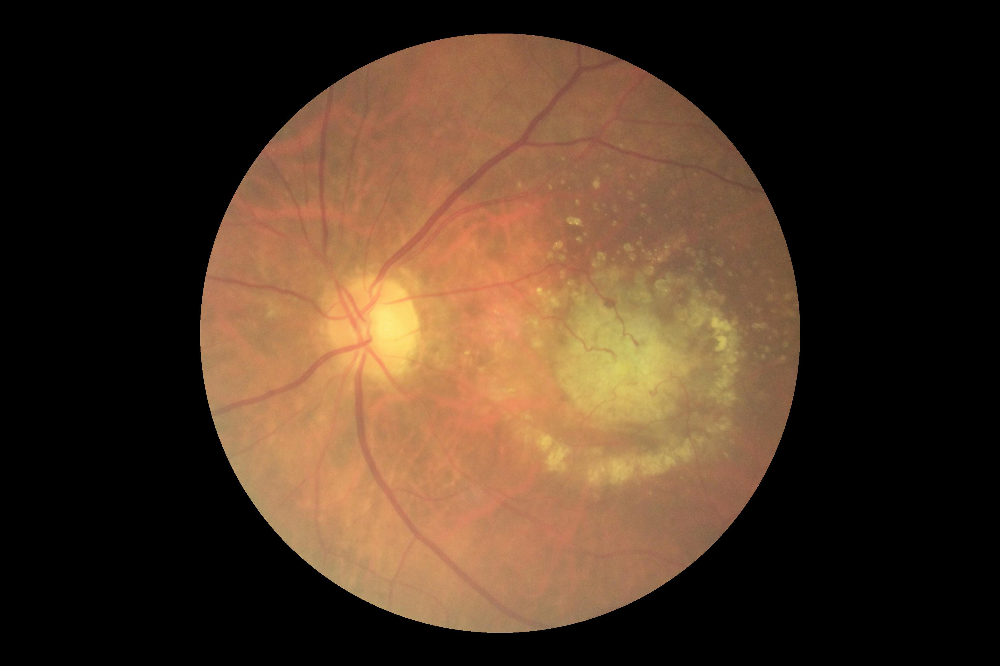

In [54]:
Image.open("/content/gdrive/MyDrive/ODIR-5K/ODIR-5K/Training Images/43_left.jpg")

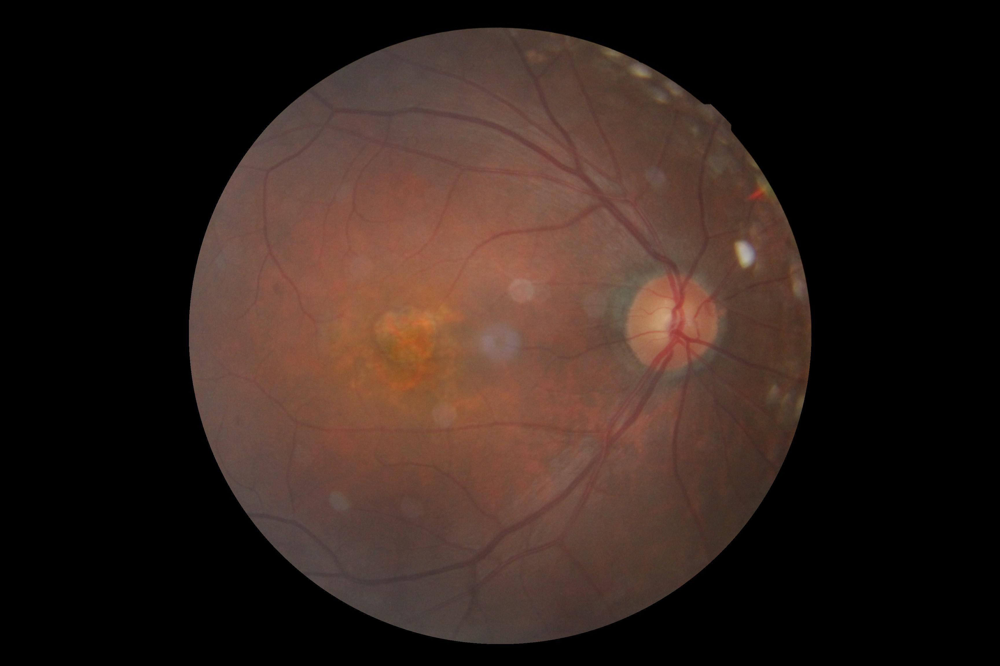

In [57]:
Image.open("/content/gdrive/MyDrive/ODIR-5K/ODIR-5K/Training Images/153_right.jpg")

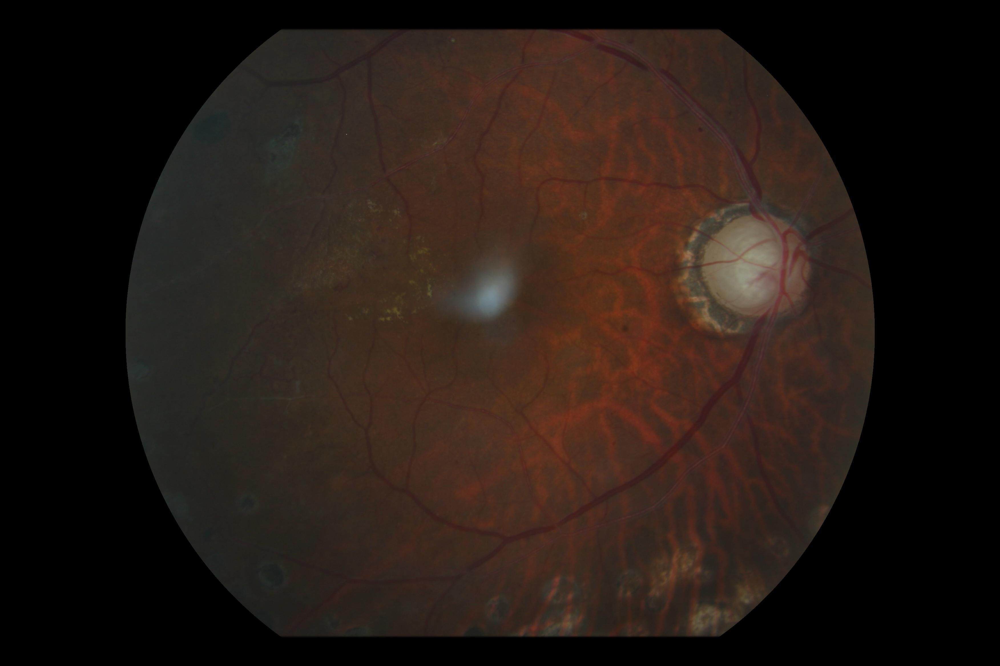

In [59]:
Image.open("/content/gdrive/MyDrive/ODIR-5K/ODIR-5K/Training Images/2063_right.jpg")

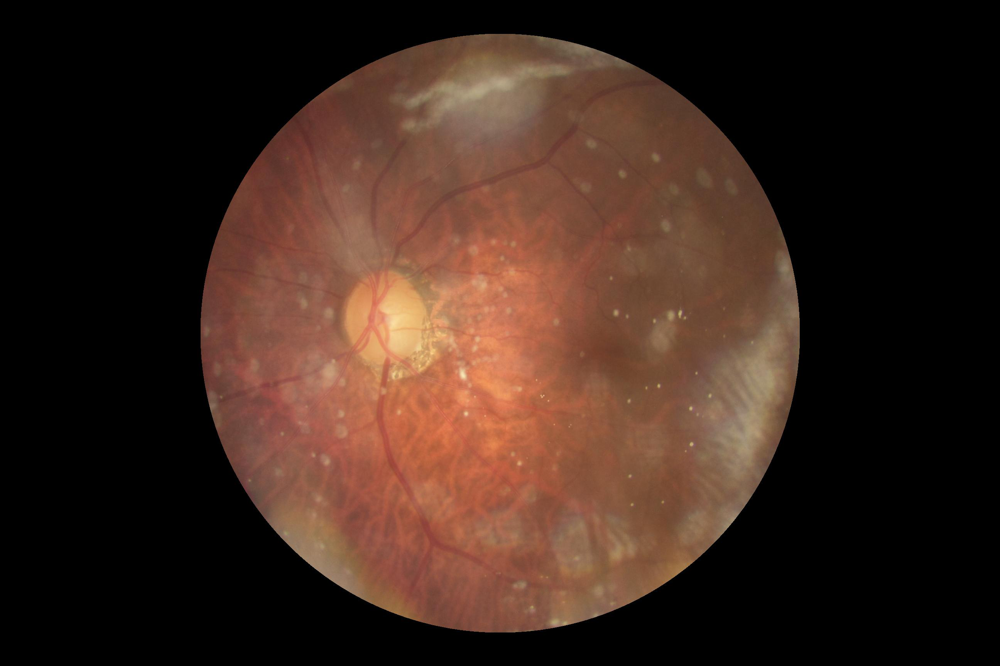

In [61]:
Image.open("/content/gdrive/MyDrive/ODIR-5K/ODIR-5K/Training Images/167_left.jpg")

In [62]:
### Non-Glaucoma

In [63]:
df[df.G==0]

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0
8,8,59,Male,8_left.jpg,8_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0
84,84,51,Female,84_left.jpg,84_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0
191,191,51,Female,191_left.jpg,191_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0
393,394,63,Male,394_left.jpg,394_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2826,3485,70,Male,3485_left.jpg,3485_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0
3015,4149,55,Male,4149_left.jpg,4149_right.jpg,low image quality,low image quality,1,0,0,0,0,0,0,0
3147,4290,51,Male,4290_left.jpg,4290_right.jpg,low image quality,normal fundus,1,0,0,0,0,0,0,0
3399,4571,51,Male,4571_left.jpg,4571_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0


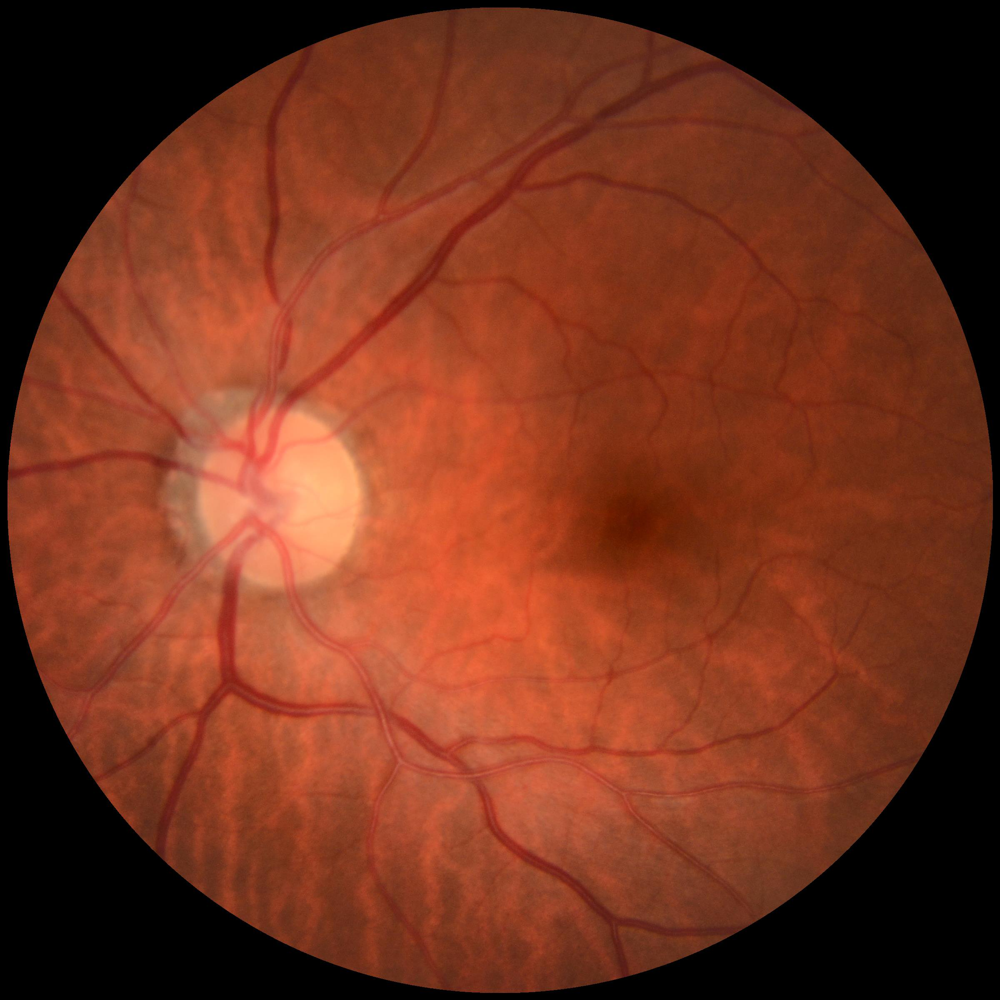

In [65]:
Image.open("/content/gdrive/MyDrive/ODIR-5K/ODIR-5K/Training Images/8_left.jpg")

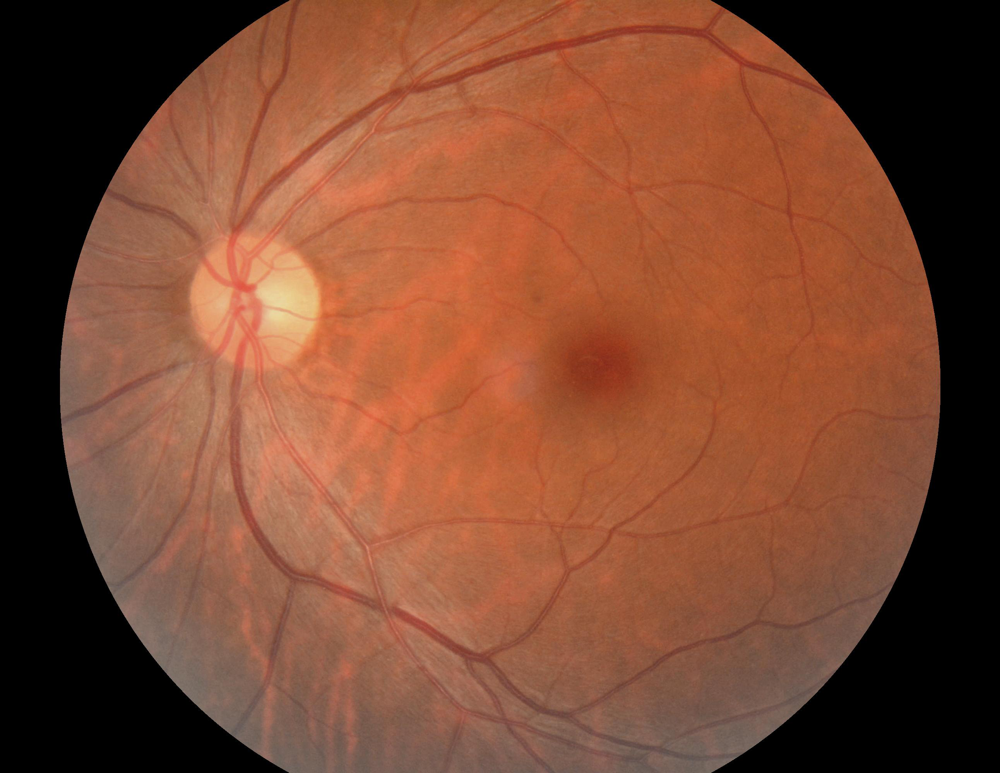

In [66]:
Image.open("/content/gdrive/MyDrive/ODIR-5K/ODIR-5K/Training Images/84_left.jpg")

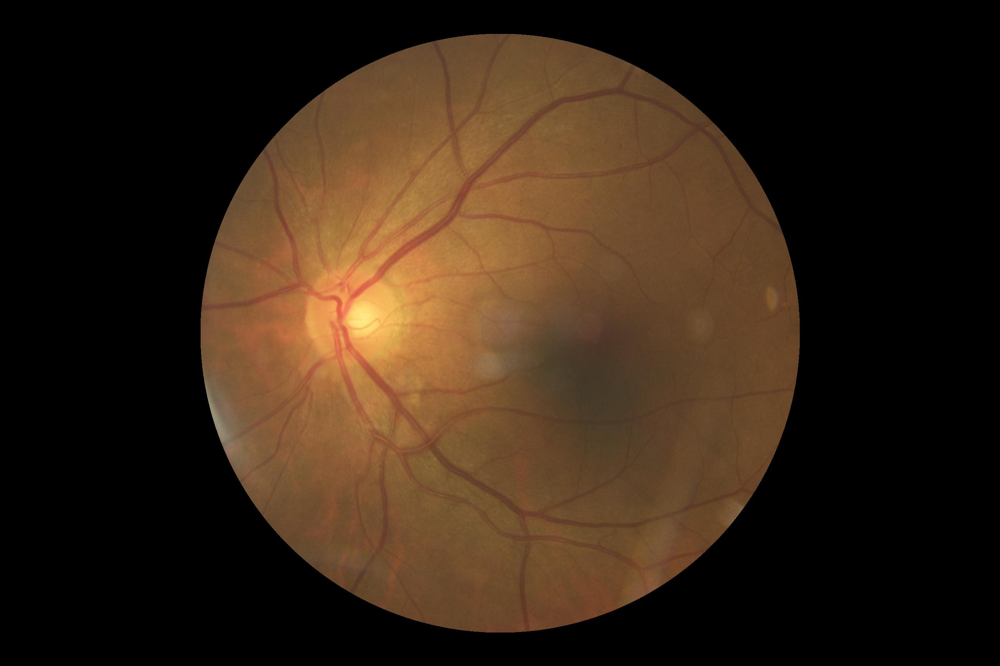

In [68]:
Image.open("/content/gdrive/MyDrive/ODIR-5K/ODIR-5K/Training Images/191_left.jpg")

In [69]:
### dataset

In [70]:
df

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0
8,8,59,Male,8_left.jpg,8_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0
30,30,66,Female,30_left.jpg,30_right.jpg,post laser photocoagulation，glaucoma,post laser photocoagulation,0,0,1,0,0,0,0,1
43,43,35,Male,43_left.jpg,43_right.jpg,wet age-related macular degeneration,dry age-related macular degeneration，glaucoma,0,0,1,0,1,0,0,0
84,84,51,Female,84_left.jpg,84_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2826,3485,70,Male,3485_left.jpg,3485_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0
3015,4149,55,Male,4149_left.jpg,4149_right.jpg,low image quality,low image quality,1,0,0,0,0,0,0,0
3147,4290,51,Male,4290_left.jpg,4290_right.jpg,low image quality,normal fundus,1,0,0,0,0,0,0,0
3399,4571,51,Male,4571_left.jpg,4571_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0


In [92]:
df = pd.read_excel('/content/gdrive/MyDrive/ODIR-5K/ODIR-5K/data.xlsx')

In [93]:
def has_glaucoma(text):
  return "glaucoma" in text

def is_normal(text):
  return "normal fundus" in text

In [94]:
df['glaucoma_left'] = df["Left-Diagnostic Keywords"].apply(lambda x: has_glaucoma(x))

In [95]:
df['glaucoma_right'] = df["Right-Diagnostic Keywords"].apply(lambda x: has_glaucoma(x))

In [96]:
df['normal_left'] = df["Left-Diagnostic Keywords"].apply(lambda x: is_normal(x))

In [97]:
df['normal_right'] = df["Right-Diagnostic Keywords"].apply(lambda x: is_normal(x))

In [99]:
df = df[['Left-Fundus', 'Right-Fundus', 'glaucoma_left', 'glaucoma_right', 'normal_left', 'normal_right']]

In [114]:
df = df[df.glaucoma_left | df.glaucoma_right | df.normal_left | df.normal_right]

In [135]:
df

,Left-Fundus,Right-Fundus,glaucoma_left,glaucoma_right,normal_left,normal_right
0,0_left.jpg,0_right.jpg,False,False,False,True
1,1_left.jpg,1_right.jpg,False,False,True,True
3,3_left.jpg,3_right.jpg,False,False,True,False
8,8_left.jpg,8_right.jpg,False,False,True,True
9,9_left.jpg,9_right.jpg,False,False,True,False
...,...,...,...,...,...,...
3481,4660_left.jpg,4660_right.jpg,False,False,False,True
3485,4671_left.jpg,4671_right.jpg,False,False,False,True
3486,4672_left.jpg,4672_right.jpg,False,False,True,False
3494,4683_left.jpg,4683_right.jpg,False,False,True,False


In [128]:
glaucoma = pd.concat([df[df.glaucoma_right][['Right-Fundus']].rename({"Right-Fundus": "image"}, axis=1), df[df.glaucoma_left][['Left-Fundus']].rename({"Left-Fundus": "image"}, axis=1)])

In [134]:
glaucoma.reset_index(drop=True).to_csv('/content/gdrive/MyDrive/glaucoma.csv', index=False)

In [137]:
normal = pd.concat([df[df.normal_right][['Right-Fundus']].rename({"Right-Fundus": "image"}, axis=1), df[df.normal_left][['Left-Fundus']].rename({"Left-Fundus": "image"}, axis=1)])

In [138]:
normal.reset_index(drop=True).to_csv('/content/gdrive/MyDrive/normal.csv', index=False)